  Activating project at `~/Library/CloudStorage/Dropbox/My/Articles/ImplicitTriang/JuliaImp`


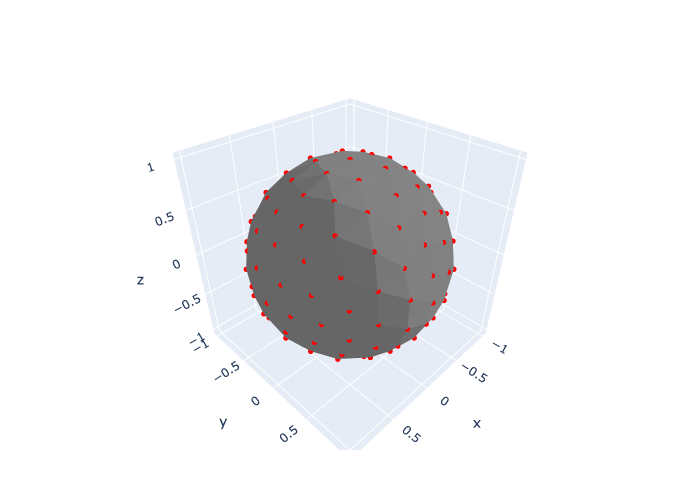

In [1]:
using Pkg
Pkg.activate(".")
using PlotlyJS
using DelimitedFiles
using Statistics
using Flux
using Optim
using LinearAlgebra: norm, dot, cross
using Clustering: dbscan

function torusJet(R=2, r=1, ax=0.2, ay=-0.2)
    f(x, y, z) = (sqrt(x^2 + y^2) - R)^2 + (z - ax * x^2 - ay * y^2)^2 - r^2
    function ∇f(x, y, z)
        g = gradient(f, x, y, z)
        return [g[1], g[2], g[3]]
    end
    return f, ∇f
end

function random_points(box, n)
    xs = rand(n) .* (box[2] - box[1]) .+ box[1]
    ys = rand(n) .* (box[4] - box[3]) .+ box[3]
    zs = rand(n) .* (box[6] - box[5]) .+ box[5]
    return xs, ys, zs
end

function evolve_points(energy, xs, ys, zs)
    n = length(xs)
    for i in 1:n
        sol = optimize(energy, [xs[i], ys[i], zs[i]])
        p = sol.minimizer
        xs[i] = p[1]
        ys[i] = p[2]
        zs[i] = p[3]
    end
end

function get_energy(a1, a2, d)
    function energy(p)
        e1 = f(p...)^2
        g = ∇f(p...)
        h = g / norm(g) - d / norm(d)
        e2 = dot(h, h)
        return a1 * e1 + a2 * e2
    end
end

function line_points(p1, p2, steps)
    l = LinRange(0, 1, steps + 1)
    sps = zeros(1 + steps, 3)
    sps[1, :] = p1
    for i = 1:3
        sps[2:end, i] = p1[i] .+ l[2:end] .* (p2[i] - p1[i])
    end
    sps
end

function star(points, layers)
    center = mean(points,dims=1)
    star = zeros(3 * layers + 1, 3)
    for i = 1:3
        star[layers*(i-1)+1:layers*i, :] = line_points(center[1, :], points[i, :], layers)[2:end, :]
    end
    star[3*layers+1, :] = center[1, :]
    star
end


function cluster_points(xs, ys, zs)
    ps = [xs ys zs]'
    clusters = dbscan(ps, 0.05, min_neighbors=1, min_cluster_size=1)
    nxs = []
    nys = []
    nzs = []
    for cluster in clusters
        ids = cluster.core_indices
        append!(nxs, mean(xs[ids]))
        append!(nys, mean(ys[ids]))
        append!(nzs, mean(zs[ids]))
    end
    nxs, nys, nzs
end

# read data from file
l = 2
vs = readdlm("../SphereTriangulation/vertices$l.txt", Float64)
ts = readdlm("../SphereTriangulation/triangles$l.txt", Int64)
ts = ts

# Plot vs using PlotlyJS
sc = scatter3d(x=vs[:, 1], y=vs[:, 2], z=vs[:, 3], mode="markers", marker=attr(size=3, color="red"))

# create triangles graphics with veritices ns and triangles ts 

sphere_trace = GenericTrace[]
# mesh3d indexes vertices from 0, apparently!
mesh = mesh3d(x=vs[:, 1], y=vs[:, 2], z=vs[:, 3], i=ts[:, 1], j=ts[:, 2], k=ts[:, 3], color="gray", opacity=1.0, flatshading=true)

push!(sphere_trace, mesh)
push!(sphere_trace, sc)
layout = Layout(width=800, height=800, scene=attr(aspectmode="data"))
plot(sphere_trace, layout)

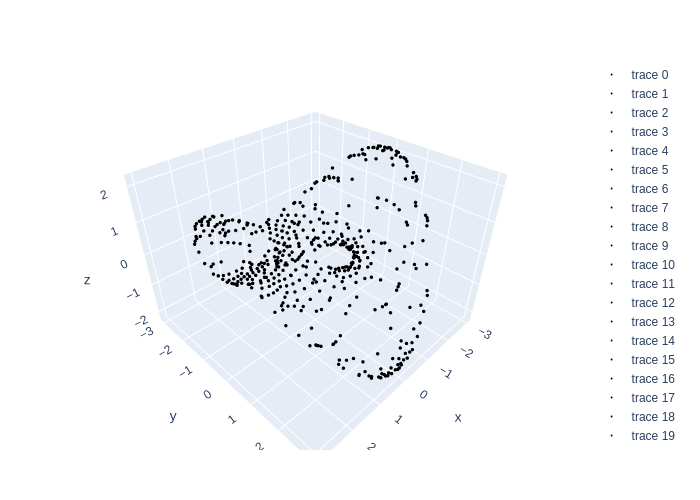

In [2]:
f, ∇f = torusJet()

data = GenericTrace[]
box = [-2.0, 2.0, -2.0, 2.0, -2.0, 2.0]

# Compute surface point cloud
#xs, ys, zs = random_points(box, 3000)
#energy = get_energy(1.0, 0.0, [0, 0, -1])
#evolve_points(energy, xs, ys, zs)
#torus_cloud = scatter3d(x=xs, y=ys, z=zs, mode="markers", marker=attr(size=2, color="blue"))

# Compute inverse point cloud
ns = [vs[i, :] for i = 1:size(vs)[1]]
for n in ns
    xs, ys, zs = random_points(box, 50)
    energy = get_energy(1.0, 0.2, n)
    evolve_points(energy, xs, ys, zs)
    xs, ys, zs = cluster_points(xs, ys, zs)
    inverse_cloud = scatter3d(x=xs, y=ys, z=zs, mode="markers", marker=attr(size=2,color="black"))
    append!(data, [inverse_cloud])
end

plot(data, layout)

In [3]:
nts = ts .+ 1
for ti = 1:10
    points = vs[nts[ti, :], :]
    st = star(points, 3)
    for i = 1:size(st)[1]
        n = st[i, :]
        xs, ys, zs = random_points(box, 15)
        energy = get_energy(1.0, 0.2, n)
        evolve_points(energy, xs, ys, zs)
        xs, ys, zs = cluster_points(xs, ys, zs)
        sc = scatter3d(x=xs, y=ys, z=zs, mode="markers", marker=attr(size=1),color="green")
        push!(data, [sc])
    end
end

plot(data, layout)

MethodError: MethodError: Cannot `convert` an object of type 
  Vector{GenericTrace{Dict{Symbol, Any}}} to an object of type 
  GenericTrace
Closest candidates are:
  convert(::Type{T}, !Matched::T) where T at Base.jl:61
  GenericTrace(::AbstractArray, !Matched::AbstractArray; kind, kwargs...) at ~/.julia/packages/PlotlyBase/4NWbR/src/convenience_api.jl:1

In [4]:
nts = ts .+ 1
ti = 5 # Triangle index
points = vs[nts[ti, :], :] # Triangle vertices
st = star(points,15)

for i = 1:size(st)[1]
    n = st[i, :]
    xs, ys, zs = random_points(box, 15)
    energy = get_energy(1.0, 0.2, n)
    evolve_points(energy, xs, ys, zs)
    xs, ys, zs = cluster_points(xs, ys, zs)
    sc = scatter3d(x=xs, y=ys, z=zs, mode="markers", marker=attr(size=3), color="green")
    push!(data, [sc])
end

plot(data, layout)

MethodError: MethodError: Cannot `convert` an object of type 
  Vector{GenericTrace{Dict{Symbol, Any}}} to an object of type 
  GenericTrace
Closest candidates are:
  convert(::Type{T}, !Matched::T) where T at Base.jl:61
  GenericTrace(::AbstractArray, !Matched::AbstractArray; kind, kwargs...) at ~/.julia/packages/PlotlyBase/4NWbR/src/convenience_api.jl:1

Points count:178280

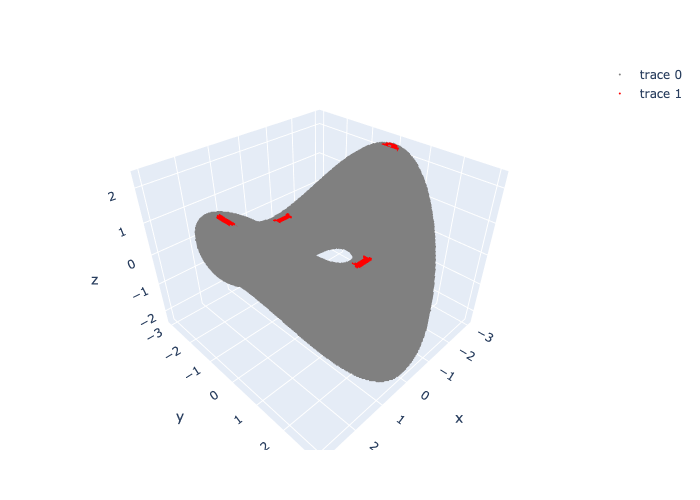

In [81]:
# create grid of points

function grid3d(box, n1, n2, n3)
    xs = range(box[1], box[2], length=n1)
    ys = range(box[3], box[4], length=n2)
    zs = range(box[5], box[6], length=n3)
    grid = zeros(n1 * n2 * n3, 3)
    for i = 1:n1
        for j = 1:n2
            for k = 1:n3
                grid[n1*n2*(i-1)+n2*(j-1)+k, :] = [xs[i], ys[j], zs[k]]
            end
        end
    end
    grid
end

g3d = grid3d([-3, 3, -3, 3, -2.5, 2.5], 128, 128, 128)
fs = [f(g3d[i, :]...) for i = 1:size(g3d)[1]]
ϵ = 0.2
ps = g3d[abs.(fs).<ϵ, :]
gs = [∇f(ps[i, :]...) for i = 1:size(ps)[1]]
# Normalize vectors in gs

gs = reduce(hcat, gs)'
gs = gs ./ sqrt.(sum(gs .^ 2, dims=2))
print("Points count:", size(ps)[1])
cond = (abs.(gs[:, 1]) .< ϵ) .&& (abs.(gs[:, 2]) .< ϵ)
qs = ps[cond, :]

# Plot ps using PlotlyJS
sc1 = scatter3d(x=ps[:, 1], y=ps[:, 2], z=ps[:, 3], mode="markers", marker=attr(size=1, color="gray"))

# Plot qs using PlotlyJS
sc2 = scatter3d(x=qs[:, 1], y=qs[:, 2], z=qs[:, 3], mode="markers", marker=attr(size=1, color="red"))

plot([sc1,sc2], layout)

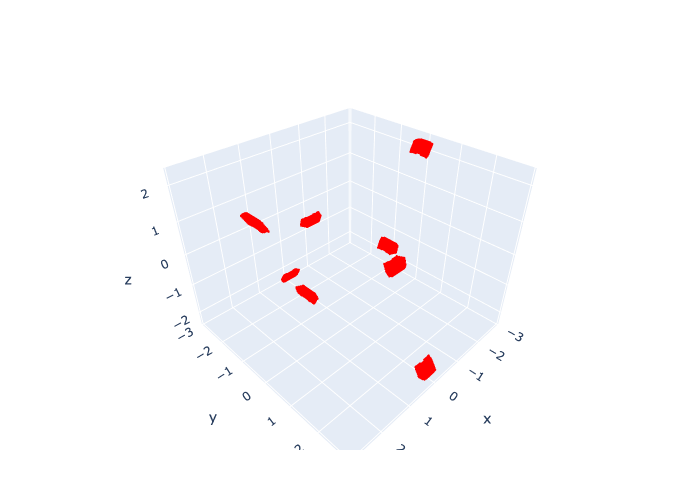

In [80]:
plot([sc2], layout)